<a href="https://colab.research.google.com/github/omerbokobza/DeepSuperResolution/blob/main/FinalModels/SR_GAN_512_64_crop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import torch.nn as nn
from torch import nn, optim
from torch.utils.data import Dataset
from torchvision import transforms
import random
import torch.nn.functional as F
!pip install kornia
import kornia
import torchvision.transforms as T

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 833.3/833.3 kB 48.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 80.2 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


#**The process**

Taking the original images ->

 crop to $512 × 512$ set it to HR ->

 downscale to $64 × 64$ ->

 Train the Generator ->

 Output $512 × 512$ ->

 Tries to "fool" the Discriminator

#Drive

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


#Downloading the data

In [ ]:
!mkdir DIV2K
!wget -O DIV2K/DIV2K_train_HR.zip http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
!unzip DIV2K/DIV2K_train_HR.zip -d DIV2K

--2024-08-30 23:31:23--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip [following]
--2024-08-30 23:31:24--  https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3530603713 (3.3G) [application/zip]
Saving to: ‘DIV2K/DIV2K_train_HR.zip’

DIV2K/DIV2K_train_H 100%[===================>]   3.29G  21.6MB/s    in 2m 32s  

2024-08-30 23:33:56 (22.2 MB/s) - ‘DIV2K/DIV2K_train_HR.zip’ saved [3530603713/3530603713]

Archive:  DIV2K/DIV2K_train_HR.zip
   creating: DIV2K/DIV2K_train_HR/
  inflating: DIV2K/DIV2K_train_HR/

In [ ]:
!wget -O DIV2K/DIV2K_valid_HR.zip http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
!unzip DIV2K/DIV2K_valid_HR.zip -d DIV2K

--2024-08-30 23:34:27--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip [following]
--2024-08-30 23:34:27--  https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 448993893 (428M) [application/zip]
Saving to: ‘DIV2K/DIV2K_valid_HR.zip’

DIV2K/DIV2K_valid_H 100%[===================>] 428.19M  21.6MB/s    in 21s     

2024-08-30 23:34:49 (20.3 MB/s) - ‘DIV2K/DIV2K_valid_HR.zip’ saved [448993893/448993893]

Archive:  DIV2K/DIV2K_valid_HR.zip
   creating: DIV2K/DIV2K_valid_HR/
  inflating: DIV2K/DIV2K_valid_HR/089

In [ ]:
# List files in the DIV2K_train_HR directories
hr_dir = 'DIV2K/DIV2K_train_HR/'
print(os.listdir(hr_dir)[:10])  # Show the first 10 files

['0103.png', '0423.png', '0230.png', '0761.png', '0503.png', '0259.png', '0636.png', '0569.png', '0593.png', '0431.png']


In [ ]:
# Set up paths for training and validation directories
train_hr_dir = 'DIV2K/DIV2K_train_HR/'
valid_hr_dir = 'DIV2K/DIV2K_valid_HR/'

In [ ]:
# train_images, test_images = train_test_split(train_images, test_size=0.1, random_state=42)
# train_images
train_images = os.listdir(train_hr_dir)
val_images = os.listdir(valid_hr_dir)
print(f'Train Before Splitting: {len(train_images)}')

test_images = random.sample(train_images, 100)
train_images = [img for img in train_images if img not in test_images]

print(f'Train After Split: {len(train_images)}, Test: {len(test_images)}, Validation: {len(val_images)}')

Train Before Splitting: 800
Train After Split: 700, Test: 100, Validation: 100


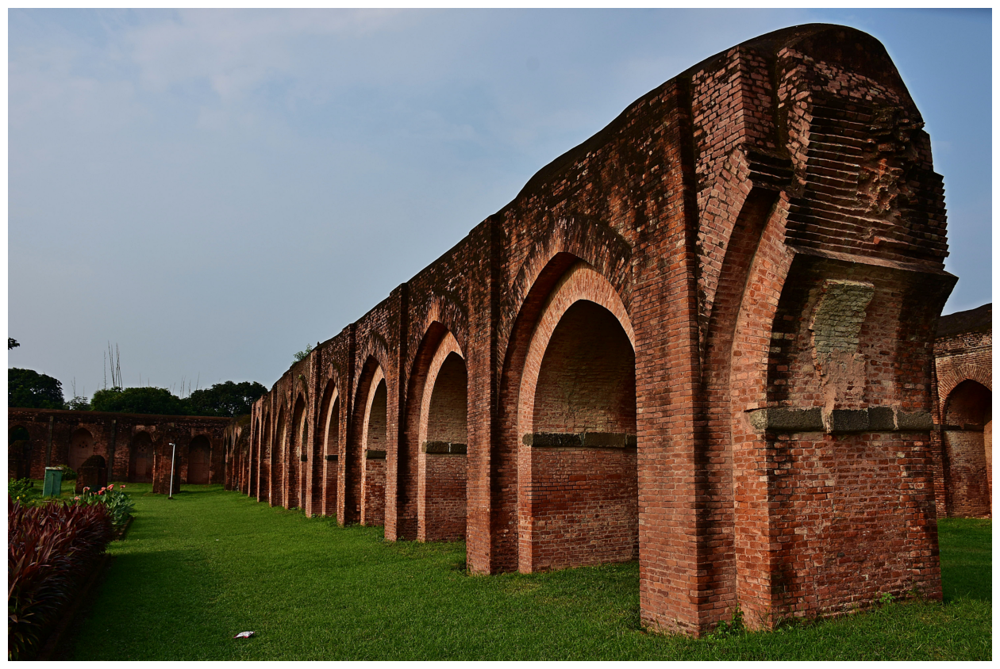

In [ ]:
# Load an example image
example_image_path = os.path.join(hr_dir, '0283.png')  # Change the filename as needed
image = Image.open(example_image_path)

# Display the image
plt.figure(figsize=(16, 16))
plt.imshow(image)
plt.axis('off')  # Hide axis labels
plt.show()

In [ ]:
print(image.size)

(2040, 1356)


In [ ]:
class DIV2KDataset(Dataset):
    def __init__(self, image_list, hr_dir, crop_size=(256, 256), scale_factor=4, transform=None):
        super(DIV2KDataset, self).__init__()
        self.image_list = image_list
        self.hr_dir = hr_dir
        self.crop_size = crop_size
        self.scale_factor = scale_factor
        self.transform = transform

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        # Load the high-resolution image
        image_path = os.path.join(self.hr_dir, self.image_list[idx])
        image = Image.open(image_path).convert('RGB')

        if image.size[0] < image.size[1]:
            image = image.rotate(-90, expand=True)

        # Random crop to the crop_size (e.g., 256x256)
        hr_image = transforms.RandomCrop(self.crop_size)(image)

        # Resize HR image to low-resolution (e.g., 64x64)
        lr_image = hr_image.resize((self.crop_size[0] // self.scale_factor, self.crop_size[1] // self.scale_factor), Image.BICUBIC)

        # Apply transformations
        hr_image = self.transform(hr_image)
        lr_image = self.transform(lr_image)

        return lr_image, hr_image

In [ ]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
# Create datasets
crop_size = (512, 512)
scale_factor = 8

train_dataset = DIV2KDataset(train_images, train_hr_dir, crop_size=crop_size, scale_factor=scale_factor, transform=transform)
valid_dataset = DIV2KDataset(os.listdir(valid_hr_dir), valid_hr_dir, crop_size=crop_size, scale_factor=scale_factor, transform=transform)
test_dataset = DIV2KDataset(test_images, train_hr_dir, crop_size=crop_size, scale_factor=scale_factor, transform=transform)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=4)


In [ ]:
for lr_imgs, hr_imgs in train_loader:
    print(f"Low-resolution images batch shape: {lr_imgs.shape}")
    print(f"High-resolution images batch shape: {hr_imgs.shape}")
    break


Low-resolution images batch shape: torch.Size([16, 3, 64, 64])
High-resolution images batch shape: torch.Size([16, 3, 512, 512])


Low-resolution image size: (64, 32)
High-resolution image size: (256, 128)


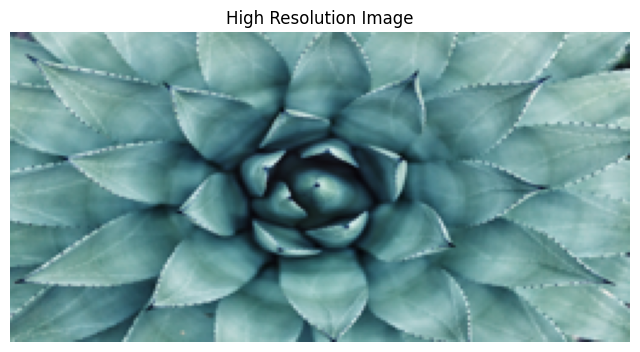

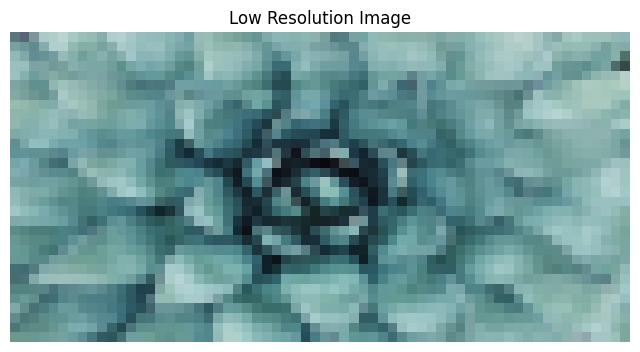

In [ ]:
# Define the inverse normalization transformation
inverse_transform = transforms.Compose([
    transforms.Normalize((-1, -1, -1), (2, 2, 2)),  # Undo the normalization
    transforms.ToPILImage()  # Convert back to a PIL image
])

# Assuming lr_image and hr_image are from the DataLoader
for lr_images, hr_images in train_loader:
    # Take the first image from the batch
    lr_image = lr_images[0]
    hr_image = hr_images[0]
    #
    # Un-normalize and convert to PIL image
    lr_image_pil = inverse_transform(lr_image)
    hr_image_pil = inverse_transform(hr_image)

    # Display the images
    print(f"Low-resolution image size: {lr_image_pil.size}")
    print(f"High-resolution image size: {hr_image_pil.size}")

    plt.figure(figsize=(8, 8))
    plt.title("High Resolution Image")
    plt.imshow(hr_image_pil)
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(8, 8))
    plt.title("Low Resolution Image")
    plt.imshow(lr_image_pil)
    plt.axis('off')
    plt.show()

    break  # Display only the first batch


# Models

##Explanation

This network enhances low-resolution images to high-resolution outputs. The architecture includes two main modules: the Generator and the Discriminator.

##SRGAN Generator
The Generator aims to convert low-resolution images into high-resolution images. It works as follows:

###Initial Convolution:
The model begins with a convolution layer that maps the low-resolution input into a 64-channel feature space. This step involves a kernel size of 9 and padding of 4 to maintain the size.

###Residual Blocks:
It employs a series of residual blocks (GeneratorResBlock), each consisting of two convolution layers with ReLU activation between them. The output of each block is added to its input (skip connection), helping the network to mitigate the vanishing gradient problem and maintain information flow.

###Transition Convolution:
After processing through the residual blocks, another convolution normalizes the feature maps without changing the number of channels (64).

###Upsampling:
The network increases the spatial dimensions through upsampling blocks. Each block consists of a convolution that increases the channel count fourfold (to prepare for pixel shuffle), followed by a PixelShuffle operation that reorganizes these channels into a higher resolution and a ReLU activation.

###Final Convolution:
The last convolution layer reduces the channel size back to 3 (RGB channels), producing the high-resolution output.

##SRGAN Discriminator
The Discriminator evaluates whether the given image is real (high-resolution) or fake (generated by the Generator). Its structure includes:

###Initial Convolution:
 Starts with a convolution layer to process the input image, followed by a LeakyReLU activation for non-linearity.

###Convolutional Network:
A series of convolutional layers that progressively downsample the image while increasing the number of feature channels. Each convolutional layer is followed by batch normalization and LeakyReLU activation to stabilize learning and introduce non-linearity.

###Flatten and Fully Connected Layers:
After convolutional layers, the image features are flattened and passed through fully connected layers. The final output is a single value produced by a sigmoid activation, indicating the probability that the input image is real.

##Operation and Training
Training the Generator: Involves optimizing the generator to fool the discriminator by producing images that look as close as possible to real high-resolution images. It uses the Mean Squared Error (MSE) loss function.

##Training the Discriminator:
Trains to differentiate between real and fake images effectively, improving its ability to identify nuances between the two.

##GAN Dynamics
Adversarial Training: Both components are trained in tandem; the discriminator improves its accuracy in detecting fakes, which in turn forces the generator to produce better images.
Loss Functions: The generator is typically trained using a combination of content loss (like MSE) and adversarial loss, which ensures both fidelity and realism in the generated images.

##Summary
This GAN architecture leverages the strengths of convolutional networks for feature extraction and transformation, along with the adversarial training concept, to significantly enhance image resolution while maintaining quality and adding realistic details.





# SRGAN - CODE

In [ ]:
class GeneratorResBlock(nn.Module):
    def __init__(self, in_channels):
        super(GeneratorResBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)

    def forward(self, x):
        residual = x
        x = self.relu(self.conv1(x))
        x = self.conv2(x)
        x += residual
        return x

class SRGAN_Generator(nn.Module):
    def __init__(self, num_res_blocks=16, upscale_factor=4):
        super(SRGAN_Generator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=9, padding=4)
        self.relu = nn.ReLU()

        layers = []
        for _ in range(num_res_blocks):
            layers.append(GeneratorResBlock(64))
        self.res_blocks = nn.Sequential(*layers)

        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)

        # Adjusting upsampling layers for desired output size
        upsample_layers = []
        for _ in range(int(upscale_factor/2)):
            upsample_layers.append(nn.Conv2d(64, 256, kernel_size=3, padding=1))
            upsample_layers.append(nn.PixelShuffle(2))  # Upscale by a factor of 2
            upsample_layers.append(nn.ReLU())

        self.upsample = nn.Sequential(*upsample_layers)

        self.conv3 = nn.Conv2d(64, 3, kernel_size=9, padding=4)

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.res_blocks(x)
        x = self.conv2(x)
        x = self.upsample(x)
        x = self.conv3(x)
        return x

# # Example usage
# generator = SRGAN_Generator(upscale_factor=6)
# lr_image = torch.randn(1, 3, 64, 64)  # Example low-resolution image
# hr_image = generator(lr_image)
# print(f"Generated HR image size: {hr_image.shape}")

Generated HR image size: torch.Size([1, 3, 512, 512])


In [ ]:
class SRGAN_Discriminator(nn.Module):
    def __init__(self, input_shape=(3, 512, 512)):
        super(SRGAN_Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1)
        self.leaky_relu = nn.LeakyReLU(0.2)

        # Convolutional layers
        self.layers = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # Additional conv layer
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Calculate the flattened size dynamically
        with torch.no_grad():
            self._flattened_size = self._calculate_flattened_size(input_shape)

        # Fully connected layers with fewer neurons
        self.fc = nn.Sequential(
            nn.Flatten(),
            nn.Linear(self._flattened_size, 512),  # Reduced size
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )

    def _calculate_flattened_size(self, input_shape):
        # Create a dummy input tensor with the same shape as the real input
        dummy_input = torch.zeros(1, *input_shape)
        dummy_output = self.leaky_relu(self.conv1(dummy_input))
        dummy_output = self.layers(dummy_output)
        # Return the flattened size
        return dummy_output.numel()

    def forward(self, x):
        x = self.leaky_relu(self.conv1(x))
        x = self.layers(x)
        x = self.fc(x)
        return x

# # Example usage
# input_shape = (3, 512, 512)
# discriminator = SRGAN_Discriminator(input_shape=input_shape)
# hr_image = torch.randn(1, 3, 512, 512)  # Example high-resolution image
# output = discriminator(hr_image)
# print(f"Discriminator output: {output.shape}")

#Train

In [ ]:
def save_checkpoint(model, epoch, val_loss, name_for_checkpoints, checkpoint_dir='checkpoints'):
    os.makedirs(checkpoint_dir, exist_ok=True)
    checkpoint_filename = f'{name_for_checkpoints}_epoch_{epoch+1}_val_loss_{val_loss:.4f}.pth'
    checkpoint_path = os.path.join(checkpoint_dir, checkpoint_filename)
    torch.save(model.state_dict(), checkpoint_path)
    print(f"Checkpoint saved: {checkpoint_path}")

In [ ]:
def train_srgans(generator, discriminator, train_loader, valid_loader, criterion, optimizer_g, optimizer_d, num_epochs=20, device='cuda', name_for_checkpoints=None):
    generator = generator.to(device)
    discriminator = discriminator.to(device)
    best_val_loss = float('inf')

    train_g_losses = []
    train_d_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}...')

        # Training Phase
        generator.train()
        discriminator.train()
        train_g_loss = 0.0
        train_d_loss = 0.0

        for lr_imgs, hr_imgs in train_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            # Train Discriminator
            optimizer_d.zero_grad()

            # Generate high-resolution images from low-resolution images
            fake_hr_imgs = generator(lr_imgs)

            # Real images, label = 1
            real_outputs = discriminator(hr_imgs)
            real_labels = torch.ones_like(real_outputs).to(device)
            loss_real = criterion(real_outputs, real_labels)

            # Fake images, label = 0
            fake_outputs = discriminator(fake_hr_imgs.detach())
            fake_labels = torch.zeros_like(fake_outputs).to(device)
            loss_fake = criterion(fake_outputs, fake_labels)

            # Total discriminator loss
            d_loss = loss_real + loss_fake
            train_d_loss += d_loss.item()

            d_loss.backward()
            optimizer_d.step()

            # Train Generator
            optimizer_g.zero_grad()

            # Adversarial loss
            fake_outputs = discriminator(fake_hr_imgs)
            g_adv_loss = criterion(fake_outputs, real_labels)

            # Content loss (Mean Squared Error between generated and real HR images)
            content_loss = criterion(fake_hr_imgs, hr_imgs)

            # Total generator loss
            g_loss = content_loss + 1e-3 * g_adv_loss  # Adversarial loss is often scaled down
            train_g_loss += g_loss.item()

            g_loss.backward()
            optimizer_g.step()

        avg_train_g_loss = train_g_loss / len(train_loader)
        avg_train_d_loss = train_d_loss / len(train_loader)
        train_g_losses.append(avg_train_g_loss)
        train_d_losses.append(avg_train_d_loss)
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Generator Loss: {avg_train_g_loss:.4f}, Train Discriminator Loss: {avg_train_d_loss:.4f}')

        # Validation Phase
        generator.eval()
        with torch.no_grad():
            val_loss = 0.0
            for lr_imgs, hr_imgs in valid_loader:
                lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
                fake_hr_imgs = generator(lr_imgs)
                val_loss += criterion(fake_hr_imgs, hr_imgs).item()

        avg_val_loss = val_loss / len(valid_loader)
        val_losses.append(avg_val_loss)
        print(f"Epoch [{epoch+1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}")

        # Save checkpoint if it's the best model so far
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            save_checkpoint(generator, epoch, avg_val_loss, name_for_checkpoints)

    # Plot training and validation loss
    plt.figure()
    plt.plot(range(1, num_epochs + 1), train_g_losses, label='Train Generator Loss')
    plt.plot(range(1, num_epochs + 1), train_d_losses, label='Train Discriminator Loss')
    plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()

    return generator



In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


Epoch 1/20...
Epoch [1/20], Train Generator Loss: 0.3445, Train Discriminator Loss: 0.1637
Epoch [1/20], Validation Loss: 0.2410
Checkpoint saved: checkpoints/srgan_crop_epoch_1_val_loss_0.2410.pth
Epoch 2/20...
Epoch [2/20], Train Generator Loss: 0.2278, Train Discriminator Loss: 0.0270
Epoch [2/20], Validation Loss: 0.1990
Checkpoint saved: checkpoints/srgan_crop_epoch_2_val_loss_0.1990.pth
Epoch 3/20...
Epoch [3/20], Train Generator Loss: 0.1909, Train Discriminator Loss: 0.0372
Epoch [3/20], Validation Loss: 0.1685
Checkpoint saved: checkpoints/srgan_crop_epoch_3_val_loss_0.1685.pth
Epoch 4/20...
Epoch [4/20], Train Generator Loss: 0.1679, Train Discriminator Loss: 0.0212
Epoch [4/20], Validation Loss: 0.1583
Checkpoint saved: checkpoints/srgan_crop_epoch_4_val_loss_0.1583.pth
Epoch 5/20...
Epoch [5/20], Train Generator Loss: 0.1594, Train Discriminator Loss: 0.0143
Epoch [5/20], Validation Loss: 0.1574
Checkpoint saved: checkpoints/srgan_crop_epoch_5_val_loss_0.1574.pth
Epoch 6/20

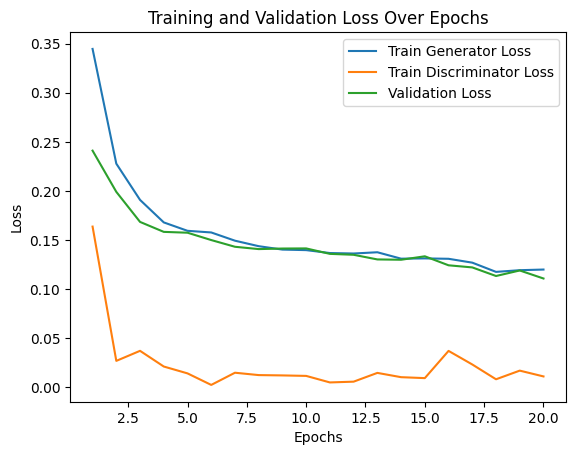

In [ ]:
# Instantiate the model, loss function, and optimizer
name_for_checkpoints = ['srgan_crop']
generator = SRGAN_Generator(upscale_factor=6)
discriminator = SRGAN_Discriminator()
criterion = nn.BCELoss()  # Binary Cross-Entropy for GAN
content_criterion = nn.L1Loss() #nn.MSELoss()  # Content loss (could also use perceptual loss)

optimizer_g = optim.Adam(generator.parameters(), lr=1e-4)
optimizer_d = optim.Adam(discriminator.parameters(), lr=1e-5)

# Train the SRGAN
trained_generator = train_srgans(
    generator=generator,
    discriminator=discriminator,
    train_loader=train_loader,
    valid_loader=valid_loader,
    criterion=content_criterion,
    optimizer_g=optimizer_g,
    optimizer_d=optimizer_d,
    num_epochs=20,
    device=device,
    name_for_checkpoints= name_for_checkpoints[0]
)

# Evaluation

In [ ]:
def calculate_psnr(output, target):
    mse = F.mse_loss(output, target)
    psnr = 10 * torch.log10(1 / mse)  # assuming images are normalized between [0, 1]
    return psnr.item()

In [ ]:
def calculate_ssim(output, target):
    # SSIM expects images to be in range [0, 1]
    output = output.clamp(0, 1)
    target = target.clamp(0, 1)

    # Calculate SSIM
    ssim_value = kornia.metrics.ssim(output, target, window_size=11).mean()
    return ssim_value.item()

# def calculate_mssim(output, target, max_val=1.0):
#     # Ensure the images are clamped to the range [0, 1]
#     output = output.clamp(0, 1)
#     target = target.clamp(0, 1)
#
#     # Calculate MSSIM at multiple scales
#     mssim_value = kornia.metrics.msssim(output, target, max_val=max_val)
#
#     return mssim_value.item()
# # Example usage
# output = torch.rand(1, 3, 256, 256)  # Replace with your model output
# target = torch.rand(1, 3, 256, 256)  # Replace with your target image
# ssim_value = calculate_ssim(output, target)
# print(f"SSIM: {ssim_value}")


def gaussian(window_size, sigma, device):
    gauss = torch.tensor([torch.exp(torch.tensor(-(x - window_size//2)**2 / float(2*sigma**2))) for x in range(window_size)], device=device)
    return gauss / gauss.sum()

def create_window(window_size, channel, device):
    _1D_window = gaussian(window_size, 1.5, device).unsqueeze(1)
    _2D_window = _1D_window.mm(_1D_window.t()).float().unsqueeze(0).unsqueeze(0)
    window = _2D_window.expand(channel, 1, window_size, window_size).contiguous()
    return window


def _ssim(img1, img2, window, window_size, channel, size_average=True):
    mu1 = F.conv2d(img1, window, padding=window_size//2, groups=channel)
    mu2 = F.conv2d(img2, window, padding=window_size//2, groups=channel)

    mu1_sq = mu1.pow(2)
    mu2_sq = mu2.pow(2)
    mu1_mu2 = mu1 * mu2

    sigma1_sq = F.conv2d(img1 * img1, window, padding=window_size//2, groups=channel) - mu1_sq
    sigma2_sq = F.conv2d(img2 * img2, window, padding=window_size//2, groups=channel) - mu2_sq
    sigma12 = F.conv2d(img1 * img2, window, padding=window_size//2, groups=channel) - mu1_mu2

    C1 = 0.01 ** 2
    C2 = 0.03 ** 2

    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) * (sigma1_sq + sigma2_sq + C2))

    if size_average:
        return ssim_map.mean()
    else:
        return ssim_map.mean(1).mean(1).mean(1)

def ssim(img1, img2, window_size=11, size_average=True):
    (_, channel, _, _) = img1.size()
    device = img1.device
    window = create_window(window_size, channel, device)

    return _ssim(img1, img2, window, window_size, channel, size_average)

def msssim(img1, img2, window_size=11, size_average=True):
    weights = torch.FloatTensor([0.0448, 0.2856, 0.3001, 0.2363, 0.1333]).to(img1.device)
    levels = weights.size()[0]
    mssim = []

    for _ in range(levels):
        ssim_map = ssim(img1, img2, window_size, size_average)
        mssim.append(ssim_map)

        if img1.size(2) == 1 or img1.size(3) == 1:
            break

        img1 = F.avg_pool2d(img1, (2, 2))
        img2 = F.avg_pool2d(img2, (2, 2))

    mssim = torch.stack(mssim)
    return (mssim * weights).sum()


In [ ]:
def evaluate_model_with_mssim(model, test_loader, device='mps'):
    model.eval()
    avg_psnr = 0.0
    avg_ssim = 0.0
    avg_mssim = 0.0
    num_batches = len(test_loader)

    with torch.no_grad():
        for lr_imgs, hr_imgs in test_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            outputs = model(lr_imgs)

            # Calculate PSNR, SSIM, and MSSIM
            psnr_value = calculate_psnr(outputs, hr_imgs)
            ssim_value = calculate_ssim(outputs, hr_imgs)
            mssim_value = msssim(outputs, hr_imgs)

            avg_psnr += psnr_value
            avg_ssim += ssim_value
            avg_mssim += mssim_value

    avg_psnr /= num_batches
    avg_ssim /= num_batches
    avg_mssim /= num_batches

    print(f'Average PSNR: {avg_psnr:.4f} dB')
    print(f'Average SSIM: {avg_ssim:.4f}')
    print(f'Average MSSIM: {avg_mssim:.4f}')

    return avg_psnr, avg_ssim, avg_mssim

# Evaluate your trained model on the test set
evaluate_model_with_mssim(trained_generator, test_loader, device=device)


Average PSNR: 15.2131 dB
Average SSIM: 0.6899
Average MSSIM: 0.7337


(15.213093893868583, 0.6899413807051522, tensor(0.7337, device='cuda:0'))

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


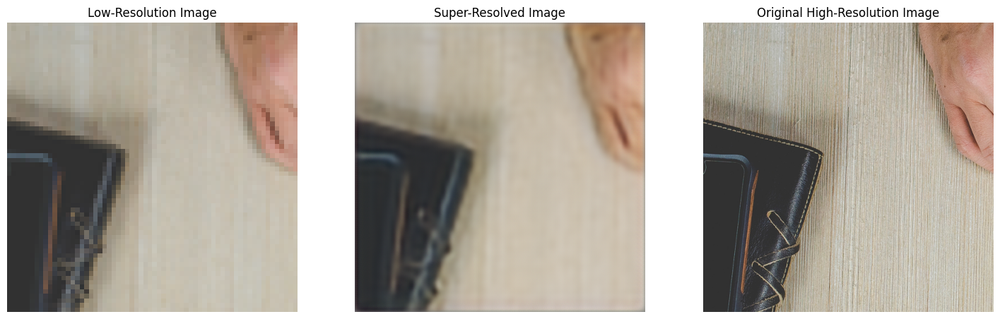

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


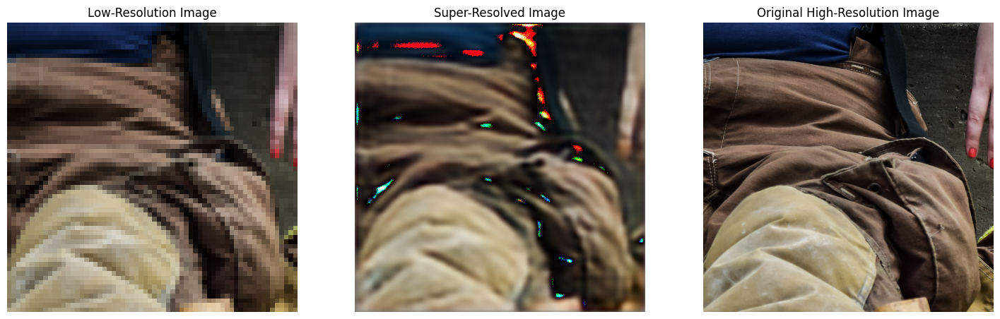

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


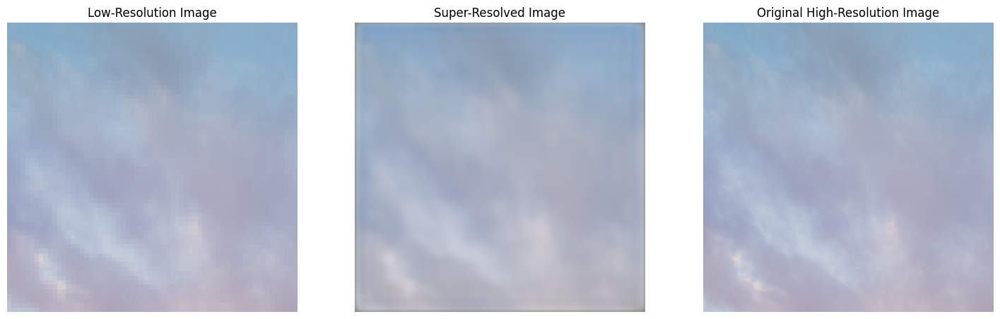

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


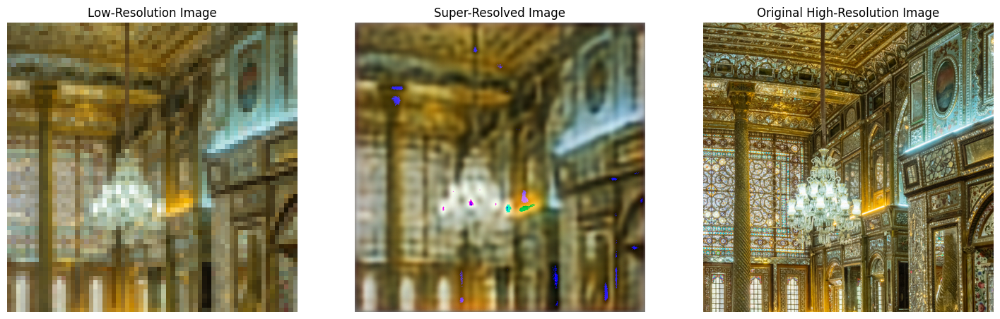

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


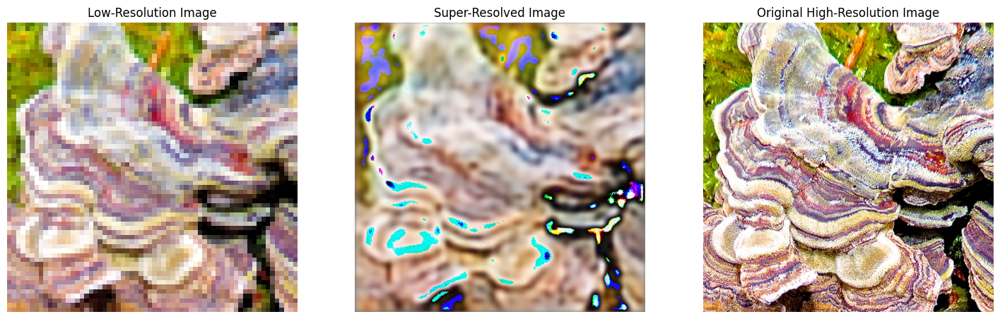

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


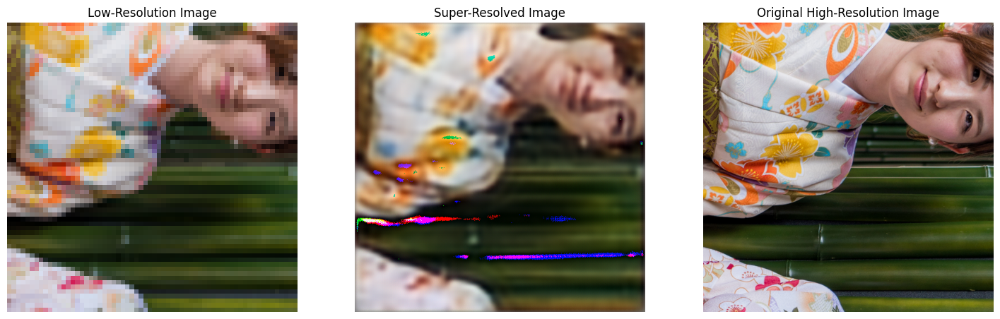

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


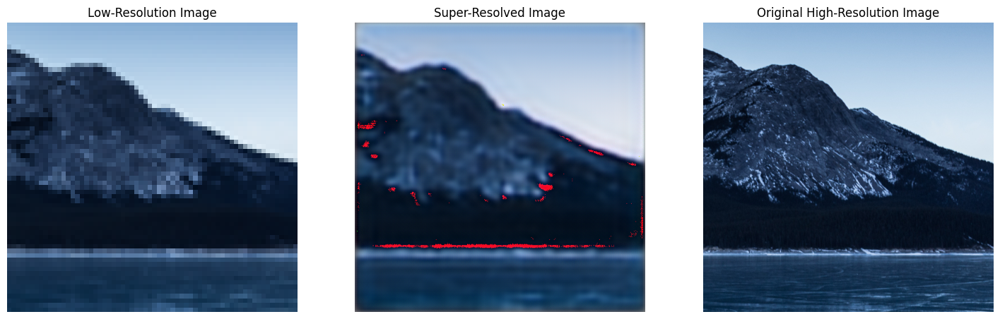

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


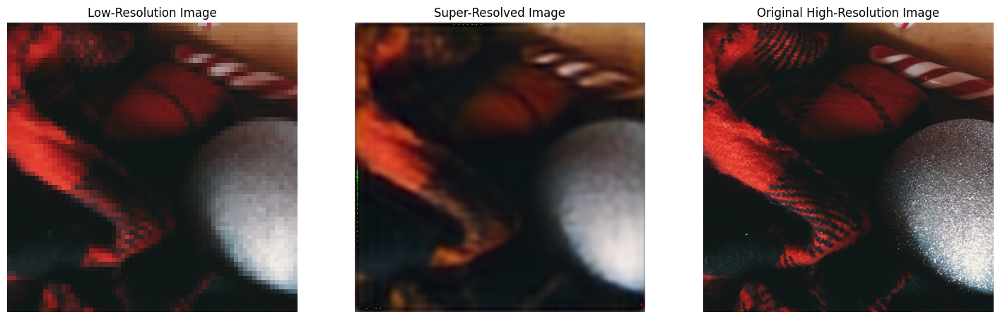

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


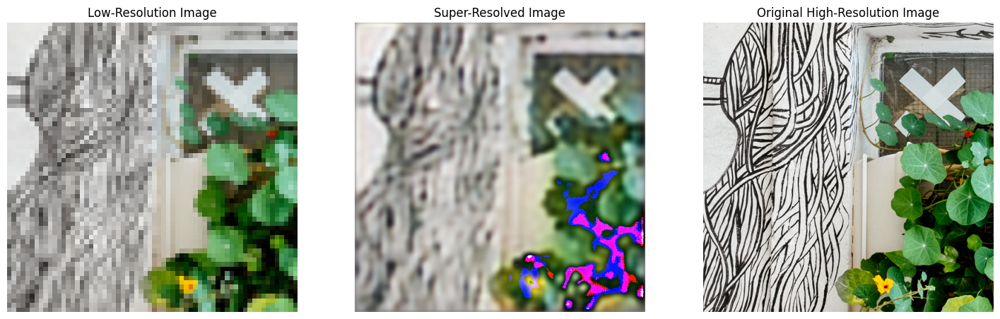

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


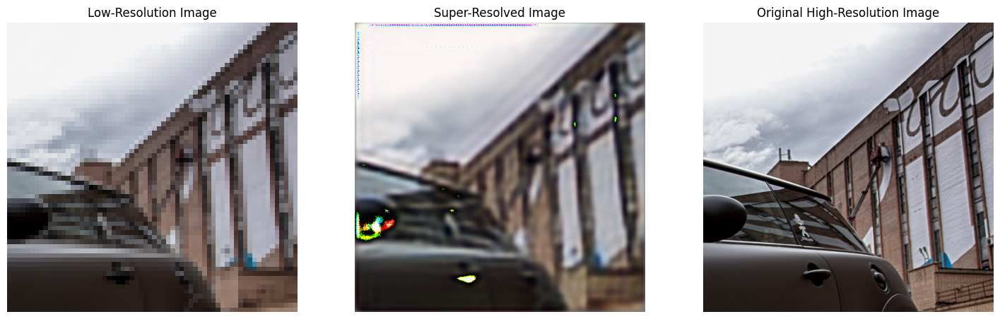

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


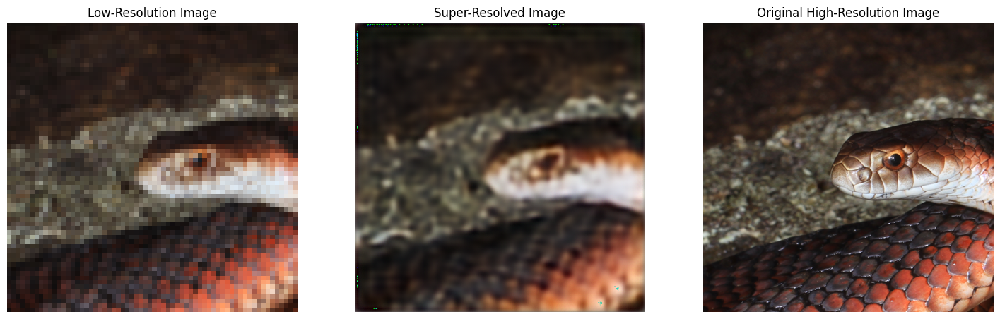

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


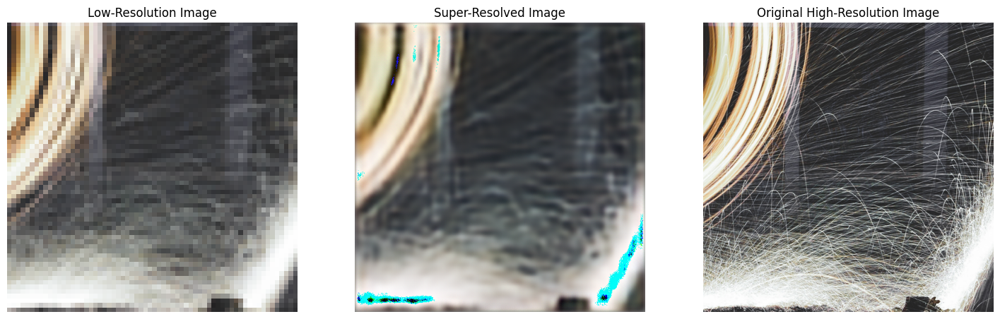

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


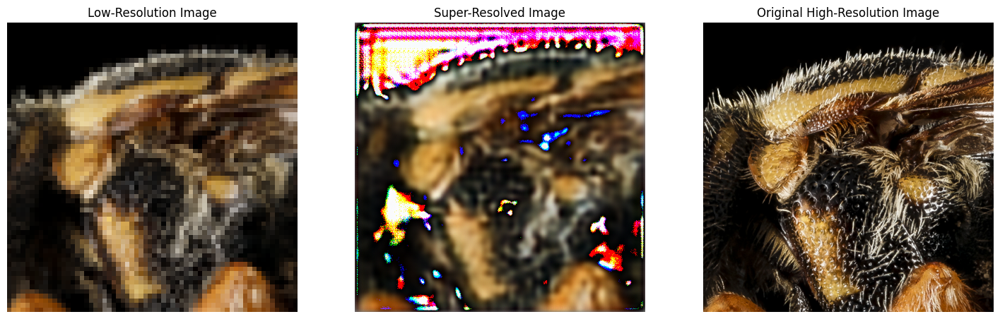

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


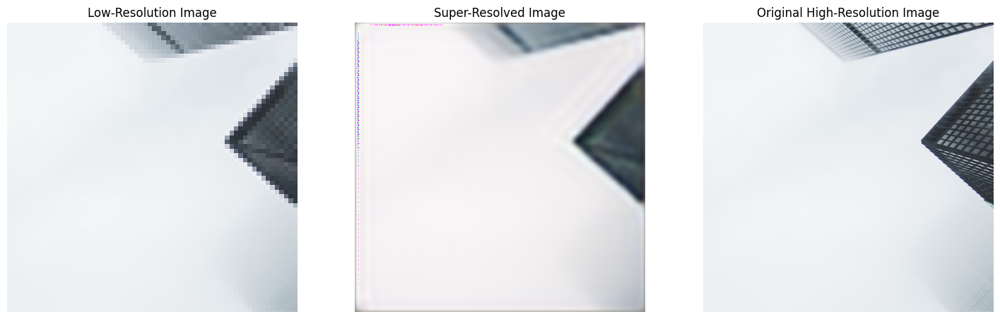

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


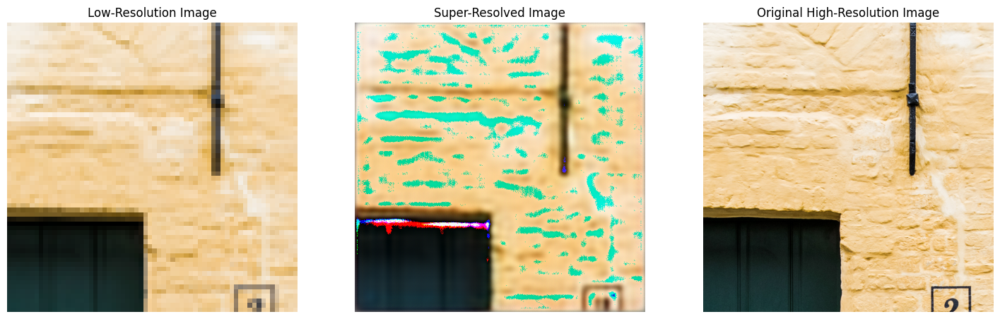

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


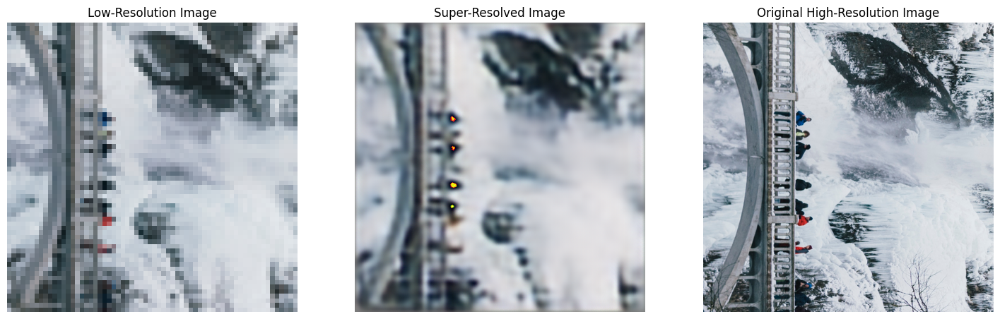

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


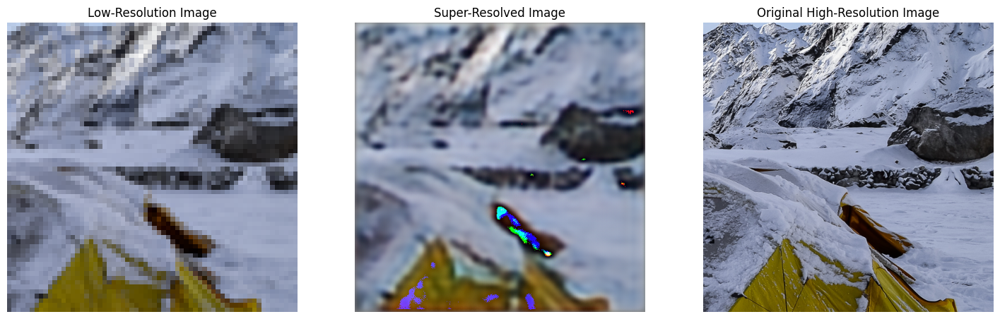

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


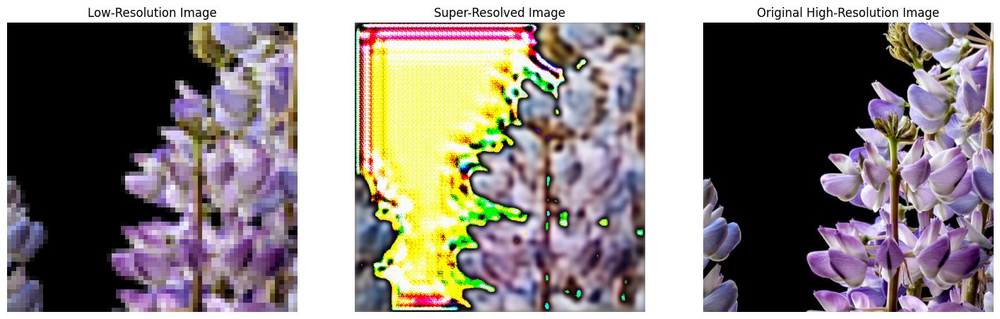

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


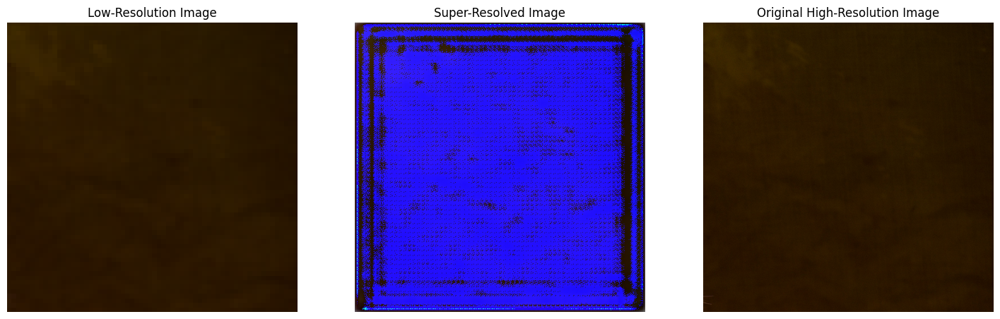

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


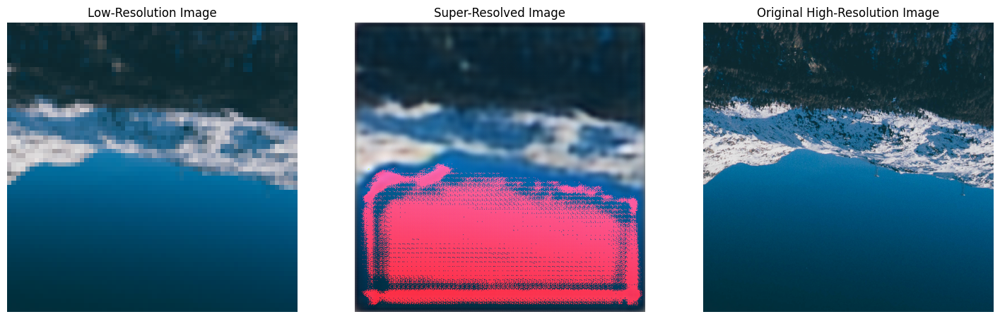

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


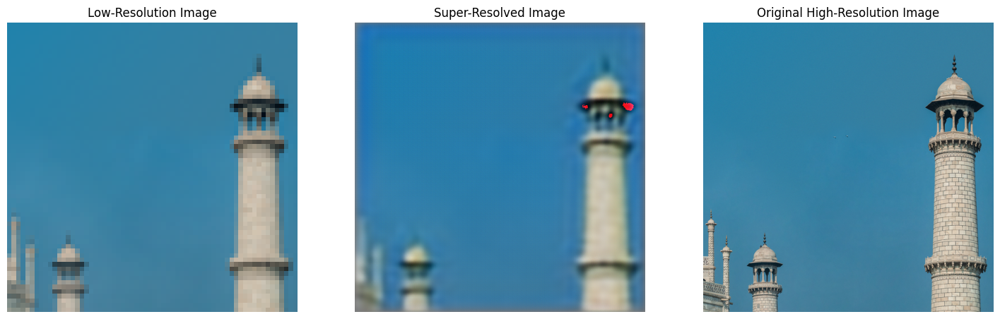

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


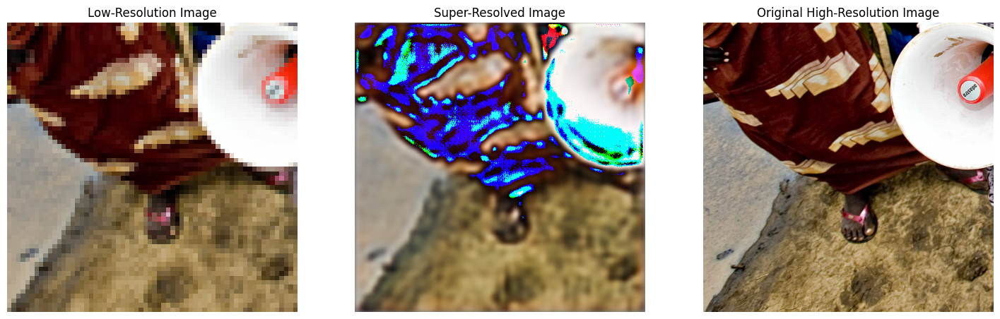

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


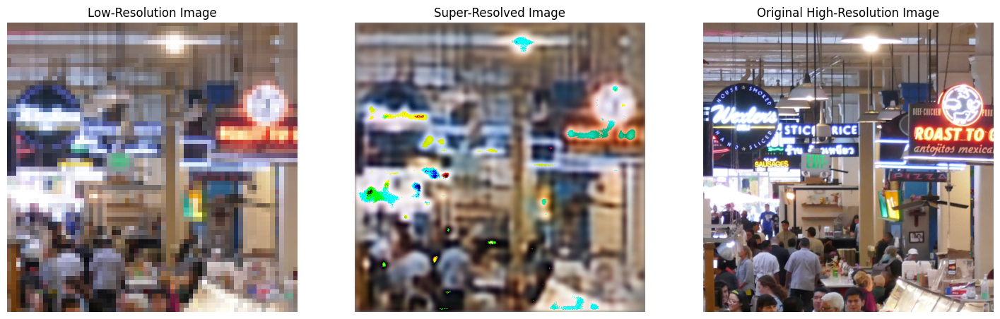

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


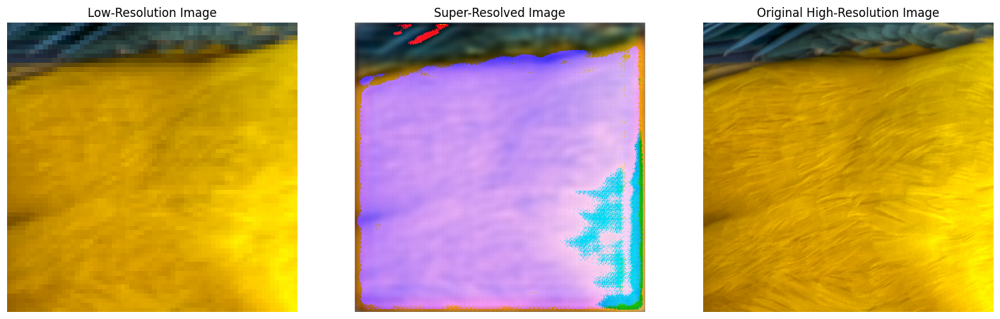

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


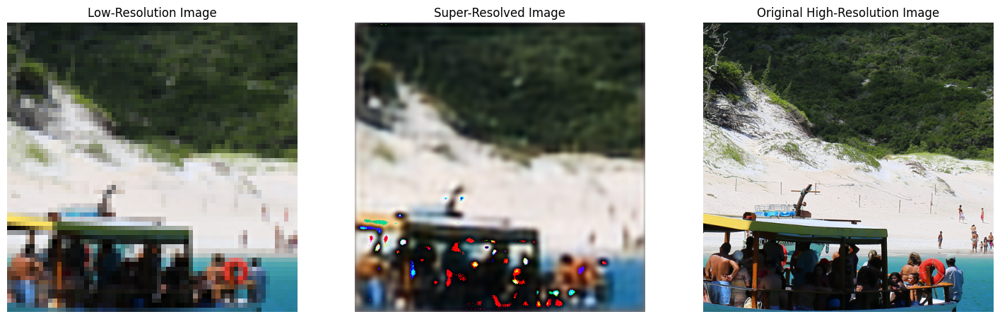

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


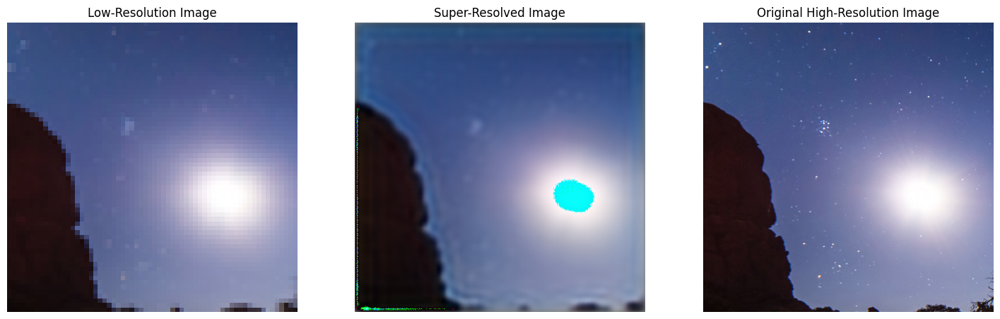

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


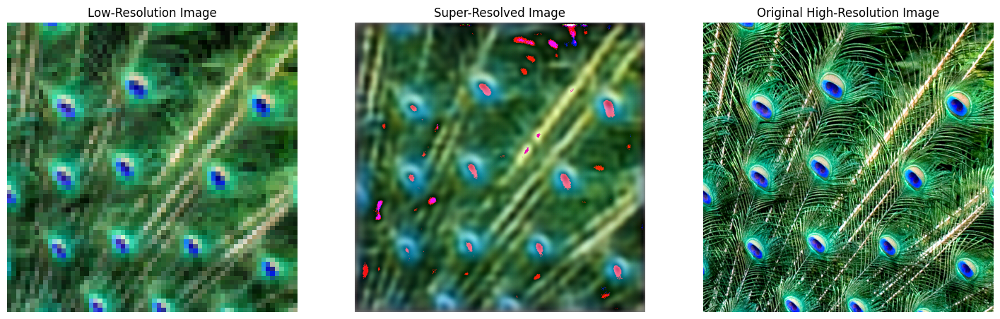

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


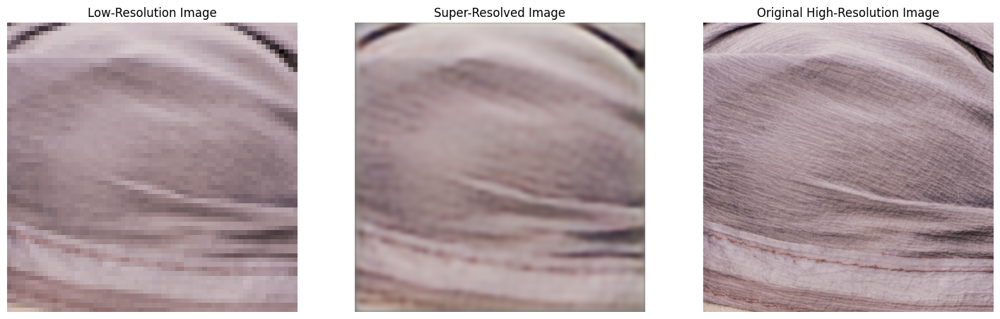

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


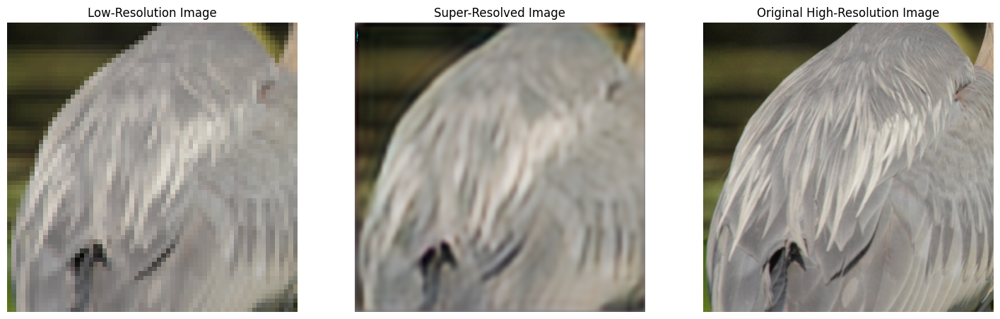

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


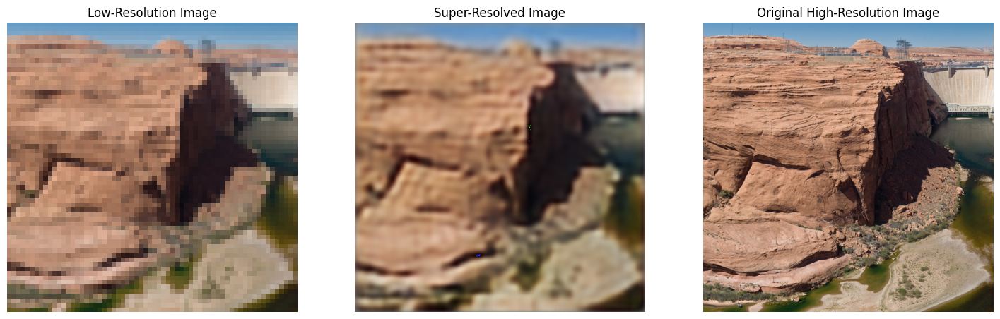

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


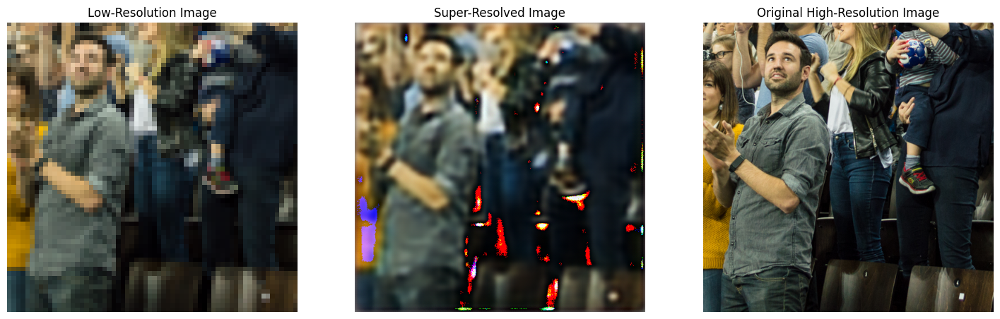

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


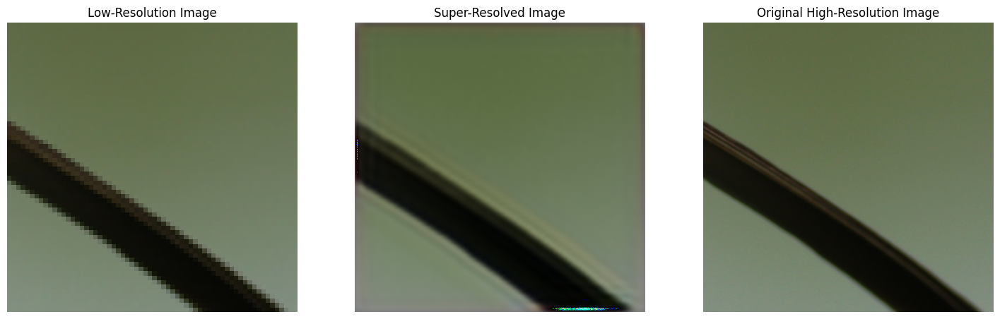

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


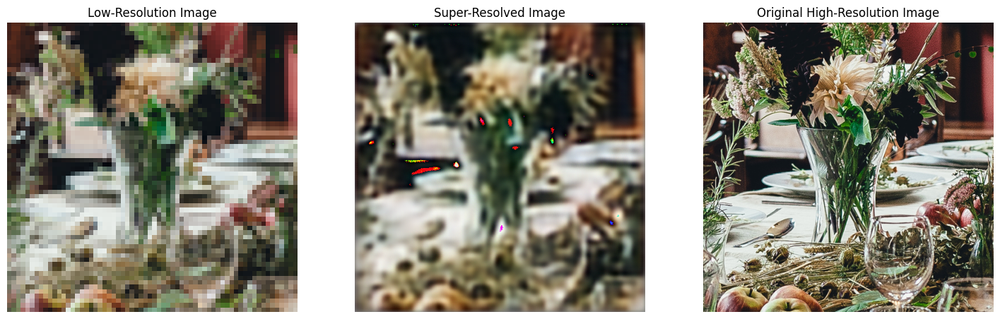

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


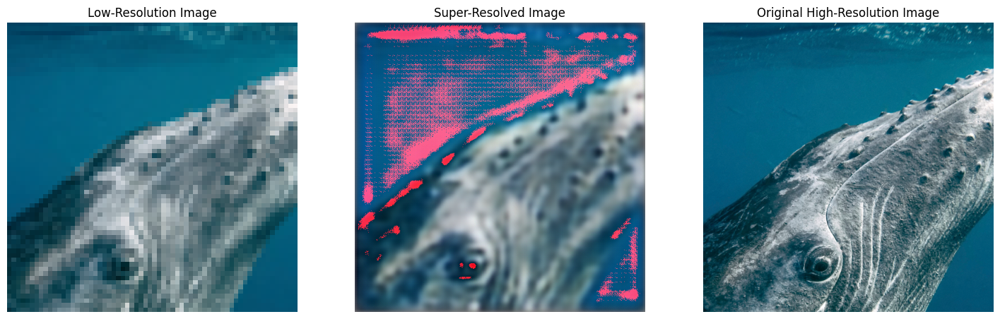

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


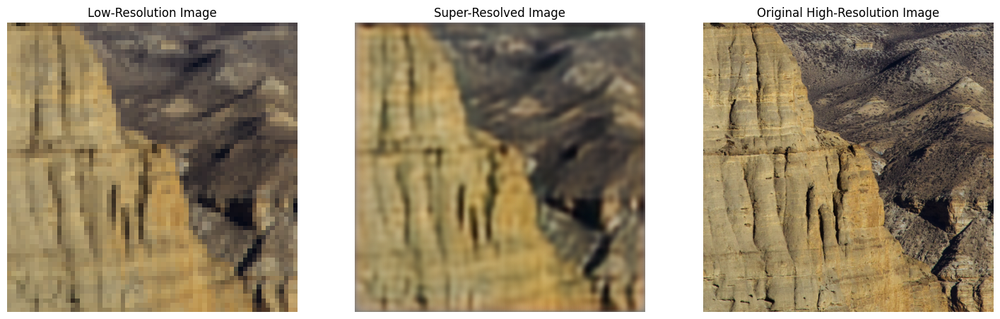

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


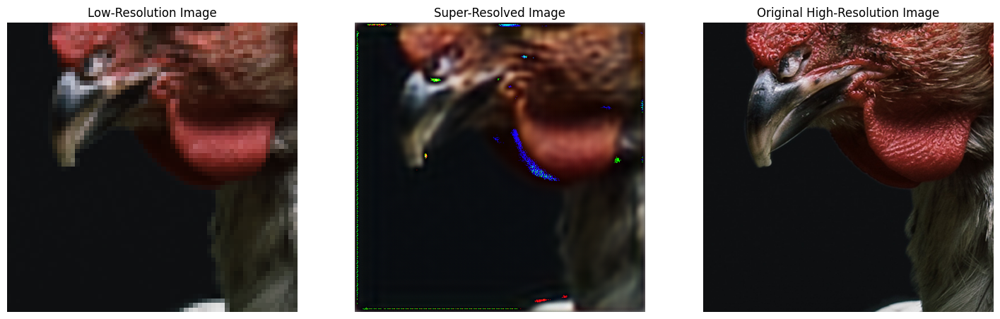

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


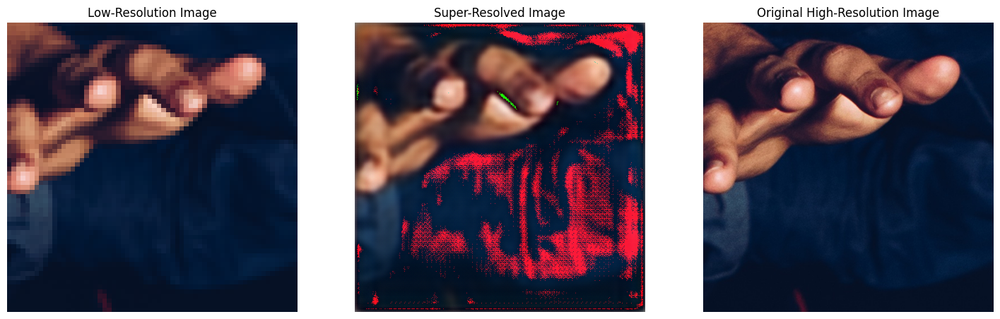

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


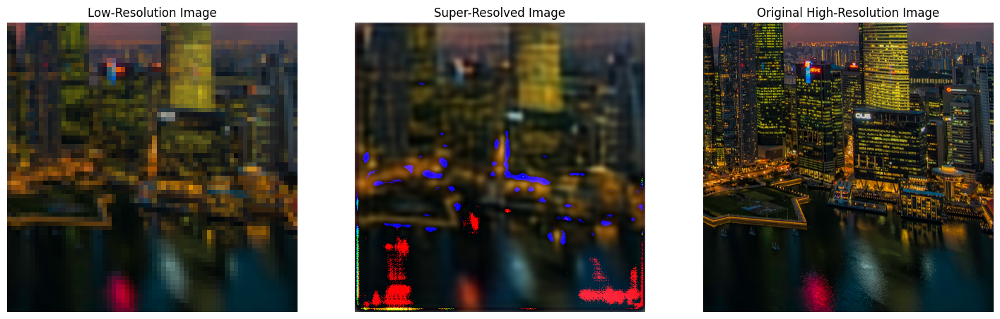

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


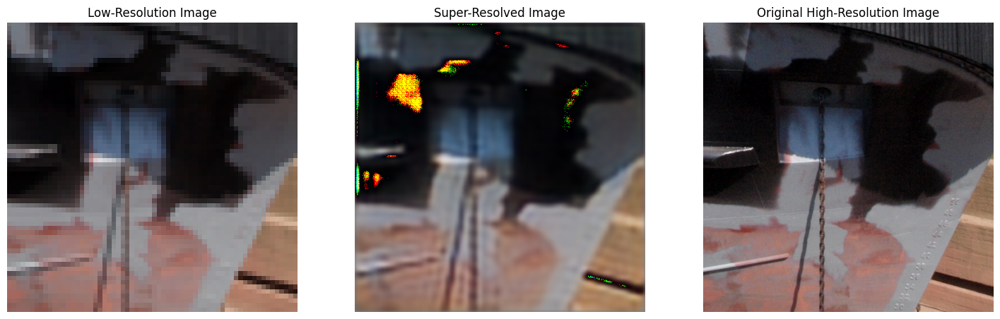

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


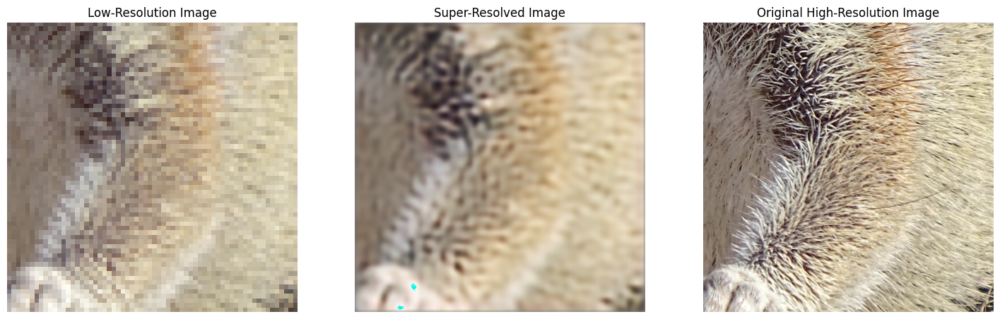

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


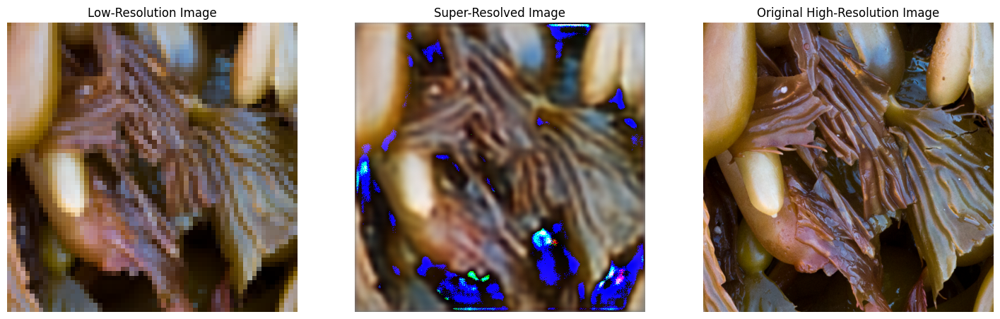

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


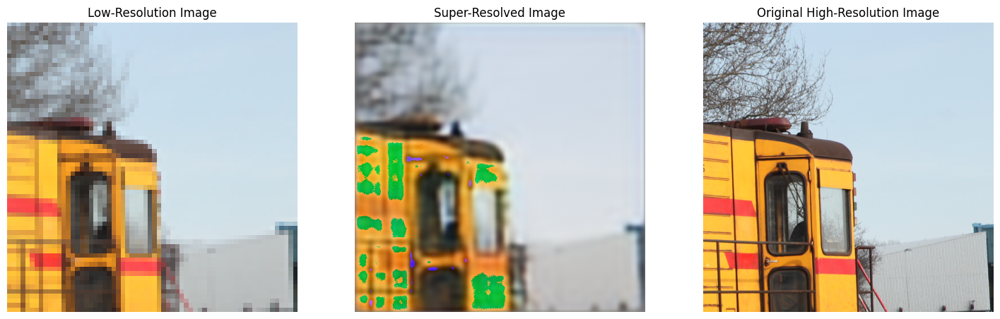

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


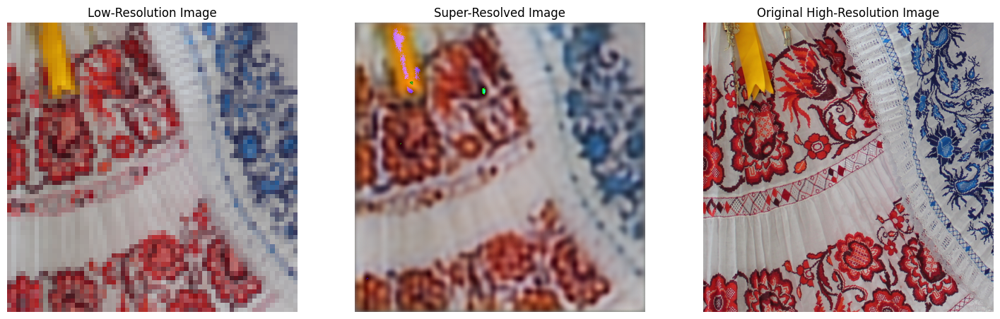

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


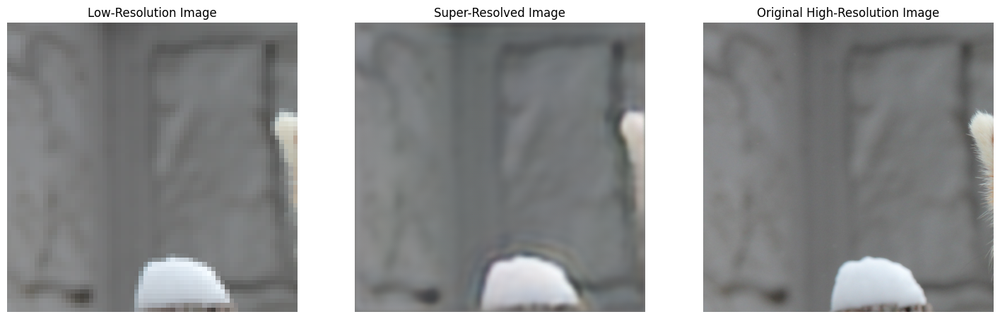

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


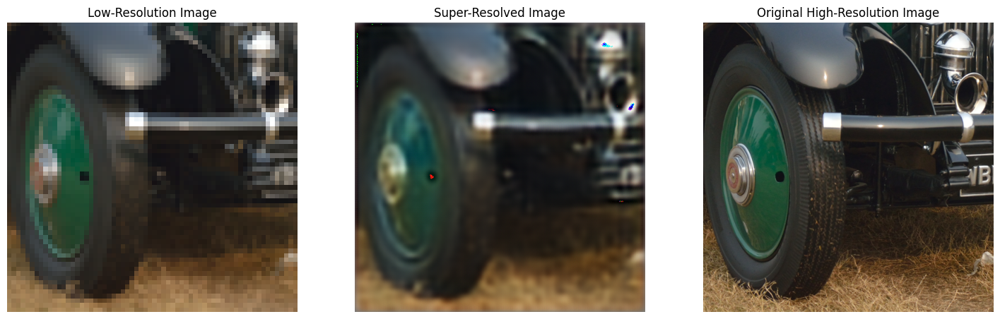

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


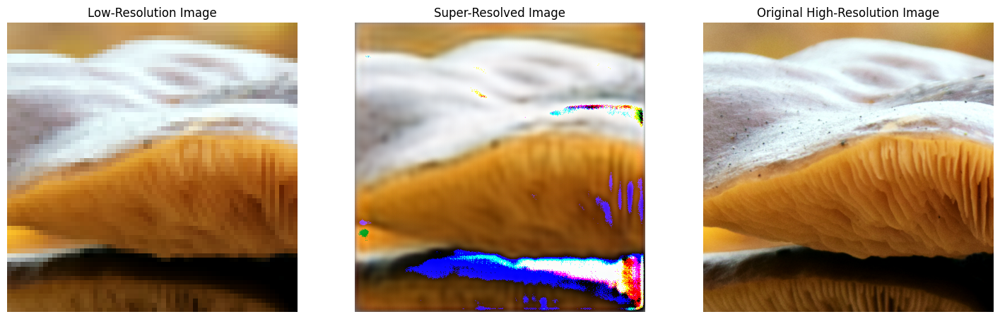

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


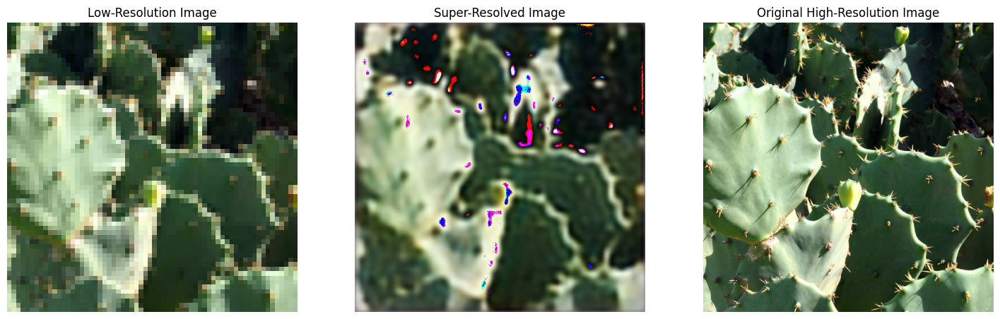

The size of the High-res id: (512, 512)
The size of the Trained-res id: (512, 512)
The size of the Low-res id: (64, 64)


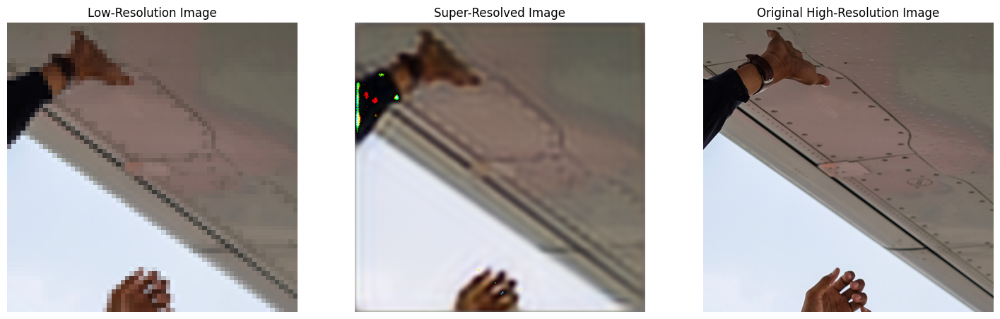

In [ ]:
def display_comparison(model, test_loader, device='mps', num_images=3):
    # Set the model to evaluation mode
    model.eval()

    # Define an inverse transform to undo normalization
    inverse_transform = T.Compose([
        T.Normalize(mean=[-0.5 / 0.5, -0.5 / 0.5, -0.5 / 0.5], std=[1 / 0.5, 1 / 0.5, 1 / 0.5]),
        T.ToPILImage()
    ])

    # Process the first few images from the test loader
    with torch.no_grad():
        for i, (lr_imgs, hr_imgs) in enumerate(test_loader):
            if i >= num_images:
                break

            # Move images to the appropriate device
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            # Generate the super-resolved image using the model
            sr_imgs = model(lr_imgs)

            # Loop through the batch
            for j in range(lr_imgs.size(0)):
                # Get the images
                lr_image = lr_imgs[j].cpu()
                sr_image = sr_imgs[j].cpu()
                hr_image = hr_imgs[j].cpu()

                # Undo normalization and convert back to PIL
                lr_image_pil = inverse_transform(lr_image)
                sr_image_pil = inverse_transform(sr_image)
                hr_image_pil = inverse_transform(hr_image)
                print(f'The size of the High-res id: {hr_image_pil.size}')
                print(f'The size of the Trained-res id: {sr_image_pil.size}')
                print(f'The size of the Low-res id: {lr_image_pil.size}')
                # Display the images side by side
                plt.figure(figsize=(18, 6))

                plt.subplot(1, 3, 1)
                plt.title('Low-Resolution Image')
                plt.imshow(lr_image_pil)
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.title('Super-Resolved Image')
                plt.imshow(sr_image_pil)
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.title('Original High-Resolution Image')
                plt.imshow(hr_image_pil)
                plt.axis('off')

                plt.show()

# Example usage:
display_comparison(trained_generator, test_loader, device=device, num_images=3)